In [1]:
import re

import tifffile
from tifffile import TiffFile
import scanpy as sc
import pandas as pd
import numpy as np
import anndata
import matplotlib.pyplot as plt
import mgitools.os_helpers as os_helpers

from skimage.io import imread
from skimage import exposure
from deepcell.applications import MultiplexSegmentation, ScaleDetection



#### convert mcd

In [2]:
from imctools.io.mcd.mcdparser import McdParser

In [57]:
fn_mcd = '../data/hyperion/b4_10062020/mcd/HT128B1 S1H4A4 100620.mcd'

parser = McdParser(fn_mcd)

In [60]:
session = parser.session

# Get all acquisition IDs
ids = parser.session.acquisition_ids

# The common class to represent a single IMC acquisition is AcquisitionData class.
# Get acquisition data for acquisition with id 2
ids

(1,)

In [61]:
ac_data = parser.get_acquisition_data(1)

In [62]:
ac_data.channel_labels

['89Y-',
 '100Ru',
 '101Ru',
 '102Ru',
 '104Ru',
 '113In',
 '115In',
 '127I',
 '131Xe',
 '138Ba',
 '139La',
 '141Pr-SMA',
 '142Nd-podoplanin',
 '143Nd-Vimentin',
 '144Nd',
 '145Nd-',
 '146Nd-CD16',
 '147Sm-CD163',
 '148Nd-PanK',
 '149Sm-CD11b',
 '150Nd-PD-L1',
 '151Eu-CD31',
 '152Sm-CD45',
 '153Eu-Lag3',
 'Sm154-CD11c',
 '155Gd-FOXP3',
 '156Gd-CD4',
 '158Gd-Ecadherin',
 '159Tb-CD68',
 '160Gd',
 '161Dy-CD20',
 '162Dy-CD8a',
 '163Dy-CD133',
 '164Dy',
 '165Ho-PD1',
 '166Er-CD74',
 '167Er-GranzymeB',
 '168Er-Ki67',
 '169Tm-Type1Coll',
 '170Er-CD3',
 '171Yb',
 '172Yb-',
 '173Yb-CD45RO',
 '174Yb-HLA-DR',
 '175Lu-FAP',
 '176YbHistoneH3',
 '190BCKG',
 '191Ir-DNA',
 '193Ir-DNA',
 '195Pt-cellseg1',
 '196Pt-cellseg2',
 '198Pt-cellseg3',
 '208Pb',
 '209Bi']

In [56]:
ac_data = parser.get_acquisition_data(4)

/home/estorrs/miniconda3/envs/imaging/lib/python3.7/site-packages/imctools/io/utils.py:43: RuntimeWarning: invalid value encountered in add
  shape = data[:, :2].max(axis=0) + 1


ValueError: can only specify one unknown dimension

In [52]:

ac_data.save_ome_tiff('../data/john_will_grant_imageing/test.ome.tiff',)

In [24]:
t = tifffile.TiffFile('../data/john_will_grant_imageing/test.ome.tiff')
t.ome_metadata

'<?xml version=\'1.0\' encoding=\'UTF-8\'?>\n<OME Creator="imctools 2.1.0" xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd"><Image ID="Image:0" Name="test.ome.tiff"><Pixels BigEndian="false" DimensionOrder="XYCZT" ID="Pixels:0" Interleaved="true" SizeC="196" SizeT="1" SizeX="1349" SizeY="1371" SizeZ="1" Type="float"><Channel Fluor="As75" ID="Channel:0:0" Name="75As" SamplesPerPixel="1" /><Channel Fluor="Se76" ID="Channel:0:1" Name="76Se" SamplesPerPixel="1" /><Channel Fluor="Se77" ID="Channel:0:2" Name="77Se" SamplesPerPixel="1" /><Channel Fluor="Se78" ID="Channel:0:3" Name="78Se" SamplesPerPixel="1" /><Channel Fluor="Br79" ID="Channel:0:4" Name="79Br" SamplesPerPixel="1" /><Channel Fluor="ArAr80" ID="Channel:0:5" Name="80ArAr" SamplesPerPixel="1" /><Channel Fluor="Kr80" ID="Channel:0:6" Name="80K

In [8]:
ac_data

AcquisitionData(acquisition=Acquisition(id=3, description=ROI_002))

In [20]:
ac_data.channel_labels

['75As',
 '76Se',
 '77Se',
 '78Se',
 '79Br',
 '80ArAr',
 '80Kr',
 '80Se',
 '81Br',
 '82Kr',
 '83Kr',
 '84Sr',
 '85Rb',
 '86Sr',
 '87Rb',
 '87Sr',
 '88Sr',
 '89Y-',
 '90Zr',
 '91Zr',
 '92Mo',
 '92Zr',
 '93Nb',
 '94Mo',
 '94Zr',
 '95Mo',
 '96Mo',
 '96Ru',
 '96Zr',
 '97Mo',
 '98Mo',
 '98Ru',
 '99Ru',
 '100Mo',
 '100Ru',
 '101Ru',
 '102Pd',
 '102Ru',
 '103Rh',
 '104Pd',
 '104Ru',
 '105Pd',
 '106Cd',
 '106Pd',
 '107Ag',
 '108Cd',
 '108Pd',
 '109Ag',
 '110Cd',
 '110Pd',
 '111Cd',
 '112Cd',
 '112Sn',
 '113Cd',
 '113In',
 '114Cd',
 '114Sn',
 '115In-',
 '115Sn',
 '116Cd',
 '116Sn',
 '117Sn',
 '118Sn',
 '119Sn',
 '120Sn',
 '120Te',
 '121Sb',
 '122Sn',
 '122Te',
 '123Sb',
 '123Te',
 '124Sn',
 '124Te',
 '124Xe',
 '125Te',
 '126Te',
 '126Xe',
 '127I',
 '128Te',
 '128Xe',
 '129Xe',
 '130Ba',
 '130Te',
 '130Xe',
 '131Xe',
 '132Ba',
 '132Xe',
 '133Cs',
 '134Ba',
 '134Xe',
 '135Ba',
 '136Ba',
 '136Ce',
 '136Xe',
 '137Ba',
 '138Ba',
 '138Ce',
 '138La',
 '139La-',
 '140Ce',
 '141Pr-SMA',
 '142Ce',
 '142N

In [63]:
ac_data.acquisition.metadata

{'ID': '1',
 'Description': 'ROI_A4',
 'AblationPower': '4.5',
 'AblationDistanceBetweenShotsX': '1',
 'AblationDistanceBetweenShotsY': '1',
 'AblationFrequency': '200',
 'AcquisitionROIID': '1',
 'OrderNumber': '0',
 'SignalType': 'Dual',
 'DualCountStart': '1',
 'DataStartOffset': '38231619',
 'DataEndOffset': '262824387',
 'StartTimeStamp': '2020-10-16T12:41:13.4282099-05:00',
 'EndTimeStamp': '2020-10-16T14:19:53.8258373-05:00',
 'AfterAblationImageEndOffset': '264999804',
 'AfterAblationImageStartOffset': '264115622',
 'BeforeAblationImageEndOffset': '264115622',
 'BeforeAblationImageStartOffset': '262824387',
 'ROIStartXPosUm': '21188446',
 'ROIStartYPosUm': '12036179',
 'ROIEndXPosUm': '22181.927',
 'ROIEndYPosUm': '11049.649',
 'MovementType': 'XRaster',
 'SegmentDataFormat': 'Float',
 'ValueBytes': '4',
 'MaxY': '992',
 'MaxX': '993',
 'PlumeStart': '1929',
 'PlumeEnd': '2313',
 'Template': 'HTAN 18 breast slides 2020-10-07',
 'ProfilingType': 'Global'}

In [29]:
ac_data.acquisition.roi_start_x_pos_um - ac_data.acquisition.roi_end_x_pos_um

20779936.439

In [30]:
ac_data.image_data

array([[[ 1.        ,  1.2320875 ,  1.        , ...,  0.        ,
          2.        ,  1.        ],
        [ 1.        ,  0.        ,  1.        , ...,  1.        ,
          0.        ,  1.        ],
        [ 0.        ,  1.        ,  0.        , ...,  0.        ,
          1.        ,  1.        ],
        ...,
        [ 2.155082  ,  0.        ,  1.        , ...,  1.        ,
          0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        , ...,  0.        ,
          0.        ,  1.4374354 ],
        [ 0.        ,  1.        ,  2.        , ...,  2.        ,
          1.        ,  0.        ]],

       [[89.83839   , 55.5875    , 54.721436  , ..., 60.033405  ,
         59.643097  , 58.926304  ],
        [83.95068   , 69.89946   , 52.2024    , ..., 75.86331   ,
         75.64912   , 62.389748  ],
        [56.252792  , 62.84387   , 78.15063   , ..., 55.600925  ,
         90.95479   , 72.51216   ],
        ...,
        [66.894264  , 67.51628   , 52.527786  , ..., 5

In [ ]:
ac_data.acquisition.

#### inspect tiffs

In [66]:
import mgitools.os_helpers as os_helpers
fps = sorted(os_helpers.listfiles('../data/hyperion/b1_01042020/ome-tiff_htan/', regex=r'.tiff$'))
fps = [fp for fp in fps if 'HT056' in fp]
fps

['../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PA_A1_A4_ROI_01.ome.tiff',
 '../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PA_A1_A4_ROI_02.ome.tiff',
 '../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PA_A1_A4_ROI_03.ome.tiff',
 '../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PB_A1_A4_ROI_01.ome.tiff',
 '../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PB_A1_A4_ROI_02.ome.tiff',
 '../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PB_A1_A4_ROI_03.ome.tiff',
 '../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PB_A1_A4_ROI_04.ome.tiff',
 '../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PB_A1_A4_ROI_05.ome.tiff']

In [68]:
from ome_types import from_tiff, from_xml
for fp in fps:
    print(fp)
    header = from_tiff(fp)
    print(header.images[0])
    

../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PA_A1_A4_ROI_01.ome.tiff
Image(
   id='Image:0',
   name='HT056P1_PA_A1_A4_ROI_01.ome.tiff',
   pixels=Pixels(
      id='Pixels:0',
      dimension_order='XYCZT',
      size_c=51,
      size_t=1,
      size_x=538,
      size_y=587,
      size_z=1,
      type='float',
      big_endian=False,
      channels=[<28 Channels>],
      interleaved=True,
      physical_size_x=538.0,
      physical_size_y=587.0,
      tiff_data_blocks=[<1 Tiff_Data_Blocks>],
   ),
)
../data/hyperion/b1_01042020/ome-tiff_htan/HT056P1_PA_A1_A4_ROI_02.ome.tiff
Image(
   id='Image:0',
   name='HT056P1_PA_A1_A4_ROI_02.ome.tiff',
   pixels=Pixels(
      id='Pixels:0',
      dimension_order='XYCZT',
      size_c=51,
      size_t=1,
      size_x=636,
      size_y=567,
      size_z=1,
      type='float',
      big_endian=False,
      channels=[<28 Channels>],
      interleaved=True,
      physical_size_x=636.0,
      physical_size_y=567.0,
      tiff_data_blocks=[<1 Tiff

#### extract nuclear and membrane markers

###### multichannel extraction (hyperion)

In [456]:
tif = TiffFile('../data/john_will_grant_imageing/S18_40270_C3_JH010721_roi1.ome.tiff')
tif

In [457]:
tif.pages[0].

In [458]:
p = tif.pages[0]
p

True

In [31]:



def extract_hyperion(fp, ome_source='halo'):
    tif = TiffFile(fp)
    d = {}
    if ome_source == 'halo':
        for page in tif.pages:
            img = page.asarray()
            channel = re.sub(r'^.*Name..(.*)SamplesPerPixel.*$', r'\1', page.description.replace('\r\n', ''))
            channel = re.sub(r'^[0-9]+[A-Z][a-z]?-?(.*)\(.*$', r'\1', channel)
            channel = re.sub(r'^[A-Z][a-z]?[0-9]+-?(.*)\(.*$', r'\1', channel)
            d[channel] = img
        d.pop('')
        
        
    else:
        description = tif.pages[0].description
        metadatas = re.findall(r'<Channel [^>]*>', p.description)
        for i, page in enumerate(tif.pages):
            img = page.asarray()
            m = metadatas[i]
            channel = re.sub(r'^.* Name..(.*). SamplesPerPixel.*$', r'\1', m)
            channel = re.sub(r'^.*-(.*)$', r'\1', channel)
            if channel and channel[0].isdigit(): channel = ''
#             channel = re.sub(r'^[0-9]+[A-Z][a-z]?-?(.*)\(.*$', r'\1', channel)
#             channel = re.sub(r'^[A-Z][a-z]?[0-9]+-?(.*)\(.*$', r'\1', channel)
            d[channel] = img
        if '' in d: d.pop('')
        
    return d
    
def extract_codex(fp):
    tifs = os_helpers.listfiles(fp, regex='.tif')
    channel_to_tif = {fp.split('/')[-1].split('.')[0].split('_')[-1]:tifffile.imread(fp) for fp in tifs}
    return channel_to_tif
    
    

In [32]:
CHANNEL_MAP = {
    
}
def rename_channels(channel_to_img):
    channel_to_img = {c.lower():v for c, v in channel_to_img.items()}
    channel_to_img = {CHANNEL_MAP.get(c, c):v for c, v in channel_to_img.items()}
    return channel_to_img

In [33]:
def merge_channels(channel_to_img, channels):
    img = None
    for c in channels:
        X = np.expand_dims(channel_to_img[c], 0)
        if img is None:
            img = X
        else:
            X = np.concatenate((img, X))
    return np.mean(img, axis=0)

###### one channel tif extraction (codex)

In [2]:
tif = TiffFile(
    '/home/estorrs/imaging/data/codex/codex_processed_hu_pancreas_TrisEDTA_2020-10-08/reg001_cyc001_ch001_DAPI1.tif')
tif

In [3]:
img = tifffile.imread(
    '/home/estorrs/imaging/data/codex/codex_processed_hu_pancreas_TrisEDTA_2020-10-08/reg001_cyc001_ch001_DAPI1.tif')
img

array([[181, 184, 171, ..., 172, 176, 176],
       [169, 162, 165, ..., 169, 172, 185],
       [172, 168, 151, ..., 149, 159, 171],
       ...,
       [154, 141, 144, ..., 196, 206, 183],
       [163, 166, 148, ..., 189, 193, 180],
       [153, 166, 157, ..., 184, 195, 195]], dtype=uint16)

In [464]:
p.description

'<?xml version=\'1.0\' encoding=\'UTF-8\'?>\n<OME Creator="imctools 2.1.0" xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd"><Image ID="Image:0" Name="S18_40270_C3_JH010721_roi1.ome.tiff"><Pixels BigEndian="false" DimensionOrder="XYCZT" ID="Pixels:0" Interleaved="true" SizeC="196" SizeT="1" SizeX="133" SizeY="138" SizeZ="1" Type="float"><Channel Fluor="As75" ID="Channel:0:0" Name="75As" SamplesPerPixel="1" /><Channel Fluor="Se76" ID="Channel:0:1" Name="76Se" SamplesPerPixel="1" /><Channel Fluor="Se77" ID="Channel:0:2" Name="77Se" SamplesPerPixel="1" /><Channel Fluor="Se78" ID="Channel:0:3" Name="78Se" SamplesPerPixel="1" /><Channel Fluor="Br79" ID="Channel:0:4" Name="79Br" SamplesPerPixel="1" /><Channel Fluor="ArAr80" ID="Channel:0:5" Name="80ArAr" SamplesPerPixel="1" /><Channel Fluor="Kr80" ID="Ch

In [465]:
re.findall(r'<Channel [^>]*>', p.description)

['<Channel Fluor="As75" ID="Channel:0:0" Name="75As" SamplesPerPixel="1" />',
 '<Channel Fluor="Se76" ID="Channel:0:1" Name="76Se" SamplesPerPixel="1" />',
 '<Channel Fluor="Se77" ID="Channel:0:2" Name="77Se" SamplesPerPixel="1" />',
 '<Channel Fluor="Se78" ID="Channel:0:3" Name="78Se" SamplesPerPixel="1" />',
 '<Channel Fluor="Br79" ID="Channel:0:4" Name="79Br" SamplesPerPixel="1" />',
 '<Channel Fluor="ArAr80" ID="Channel:0:5" Name="80ArAr" SamplesPerPixel="1" />',
 '<Channel Fluor="Kr80" ID="Channel:0:6" Name="80Kr" SamplesPerPixel="1" />',
 '<Channel Fluor="Se80" ID="Channel:0:7" Name="80Se" SamplesPerPixel="1" />',
 '<Channel Fluor="Br81" ID="Channel:0:8" Name="81Br" SamplesPerPixel="1" />',
 '<Channel Fluor="Kr82" ID="Channel:0:9" Name="82Kr" SamplesPerPixel="1" />',
 '<Channel Fluor="Kr83" ID="Channel:0:10" Name="83Kr" SamplesPerPixel="1" />',
 '<Channel Fluor="Sr84" ID="Channel:0:11" Name="84Sr" SamplesPerPixel="1" />',
 '<Channel Fluor="Rb85" ID="Channel:0:12" Name="85Rb" Samp

In [469]:
len(tif.pages)

196

In [4]:
def extract_codex(fp):
    fps = sorted(os_helpers.listfiles(fp, regex='.tif'))
    
    

##### hyperion

In [440]:
hyperior_folder = '/home/estorrs/imaging/data/ome_tiff_individual_32bit/breast_10062020/'
hyperior_folder = '../data/john_will_grant_imageing/'

In [441]:
fps = sorted(os_helpers.listfiles(hyperior_folder, regex='.tiff$'))
sample_fp_tups = []
for fp in fps:
    sample = fp.split('/')[-1].replace('.ome.tiff', '')
    sample_fp_tups.append((sample, fp))
len(sample_fp_tups), sample_fp_tups[:5]

(2,
 [('S18_40270_C3_JH010721_roi1',
   '../data/john_will_grant_imageing/S18_40270_C3_JH010721_roi1.ome.tiff'),
  ('S18_40270_C3_JH010721_roi2',
   '../data/john_will_grant_imageing/S18_40270_C3_JH010721_roi2.ome.tiff')])

In [491]:
# NUCLEAR = ['HistoneH3']
NUCLEAR = ['HistoneH3']
MEMBRANE = ['cellseg1']

sample_to_imgs = {}
for sample, fp in sample_fp_tups:
    channel_to_img = extract_hyperion(fp, ome_source='a')
    print(channel_to_img.keys())
    nuclear_img = merge_channels(channel_to_img, NUCLEAR)
    membrane_img = merge_channels(channel_to_img, MEMBRANE)
    channel_to_img['nuclear'] = nuclear_img
    channel_to_img['membrane'] = membrane_img
    sample_to_imgs[sample] = channel_to_img    

dict_keys(['SMA', 'vimentin', 'PanCK', 'PDL1', 'FOXP3', 'CD4', 'Ecadherin', 'CD68', 'CD20', 'CD8a', 'PD1', 'GranzymeB', 'Ki67', 'CollagenT1', 'CD3', 'CD45RO', 'HistoneH3', 'DNA1', 'DNA2', 'cellseg1', 'cellseg2', 'cellseg3'])
dict_keys(['SMA', 'vimentin', 'PanCK', 'PDL1', 'FOXP3', 'CD4', 'Ecadherin', 'CD68', 'CD20', 'CD8a', 'PD1', 'GranzymeB', 'Ki67', 'CollagenT1', 'CD3', 'CD45RO', 'HistoneH3', 'DNA1', 'DNA2', 'cellseg1', 'cellseg2', 'cellseg3'])


##### codex

In [34]:
codex_folder = '/home/estorrs/imaging/data/codex/spleen_codex_ruan/'

In [35]:
sample_fp_tups = [('test1', codex_folder)]

In [36]:
NUCLEAR = ['dapi1']
MEMBRANE = ['CD3']

sample_to_imgs = {}
for sample, fp in sample_fp_tups:
    channel_to_img = extract_codex(fp)
    nuclear_img = merge_channels(channel_to_img, NUCLEAR)
    membrane_img = merge_channels(channel_to_img, MEMBRANE)
    channel_to_img['nuclear'] = nuclear_img
    channel_to_img['membrane'] = membrane_img
    sample_to_imgs[sample] = channel_to_img    

#### display images

In [37]:
next(iter(sample_to_imgs.values())).keys()

dict_keys(['dapi1', 'Ki67', 'CD31', 'CD4', 'dapi11', 'CD3', 'CD8', 'CD90', 'nuclear', 'membrane'])

In [38]:
# red, green, light blue, blue, purple, yellow, white
DEFAULTS = ['#ff0000', '#00ff04', '#00fff7', '#0008ff', '#ff00e1', '#fbff00', '#ffffff']
def hex_to_rgb(h):
    h = h.replace('#', '').lower()
    return tuple(int(h[i:i+2], 16) / 255. for i in (0, 2, 4))

from skimage import color
# def colorize_bw(img, rgb):
#     grayscale_image = img / max(img.flatten())
#     p1, p2 = np.percentile(grayscale_image, (1, 98))
#     grayscale_image = exposure.rescale_intensity(grayscale_image, in_range=(p1, p2))
#     image = color.gray2rgb(grayscale_image)
    
#     colored = rgb * image
#     colored = exposure.rescale_intensity(colored, in_range=(p1, p2))
    
# #     if 
# #     img_adapteq = exposure.adjust_gamma(colored, gamma=gamma)
# #     img_adapteq = exposure.equalize_adapthist(colored, clip_limit=c)
#     return colored

# def colorize_bw_raw(img, rgb):
# #     grayscale_image = img / max(img.flatten())
#     grayscale_image = img / max(img.flatten())
#     p1, p2 = np.percentile(grayscale_image, (1, 96))
#     grayscale_image = exposure.rescale_intensity(grayscale_image, in_range=(p1, p2))
#     x = np.asarray([grayscale_image, grayscale_image, grayscale_image])
#     x = np.swapaxes(x, 0, 2)
#     colored = rgb * x
#     return colored



# def display_image_gamma(channel_to_img, channels, gamma=.03):
#     if isinstance(channels, dict):
#         channel_to_color = {ch:(hex_to_rgb(c), g) for ch, (c, g) in channels.items()}
#     else:
#         channel_to_color = {c:(hex_to_rgb(DEFAULTS[i]), .5) for i, c in enumerate(channels)}
    
#     final = None
#     for c, (color, g) in channel_to_color.items():
#         img = channel_to_img[c].copy()
#         colorized = colorize_bw(img, list(color))
#         if final is None:
#             final = exposure.adjust_gamma(colorized, gamma=g)
#         else:
#             final += exposure.adjust_gamma(colorized, gamma=g)
# #             final = (final + colorized) / np.max(final + colorized)
# #             p1, p2 = np.percentile(final, (2, 98))
# #             final = exposure.rescale_intensity(final, in_range=(p1, p2))
# #     p1, p2 = np.percentile(final, (1, 98))
# #     return exposure.rescale_intensity(final, in_range=(p1, p2))
#     return final

# def display_image_auto(channel_to_img, channels, clip_limit=.03):
#     if isinstance(channels, dict):
#         channel_to_color = {ch:hex_to_rgb(c) for ch, c in channels.items()}
#     else:
#         channel_to_color = {c:hex_to_rgb(DEFAULTS[i]) for i, c in enumerate(channels)}
    
#     final = None
#     for c, color in channel_to_color.items():
#         img = channel_to_img[c].copy()
# #         colorized = colorize_bw(img, list(color))
#         colorized = colorize_bw_raw(img, list(color))
#         if final is None:
#             final = exposure.equalize_adapthist(colorized, clip_limit=clip_limit)
# #             final = exposure.equalize_hist(colorized, )
#         else:
#             final += exposure.equalize_adapthist(colorized, clip_limit=clip_limit)
# #             final += exposure.equalize_hist(colorized, )
# #             final = (final + colorized) / np.max(final + colorized)
# #             p1, p2 = np.percentile(final, (2, 98))
# #             final = exposure.rescale_intensity(final, in_range=(p1, p2))
#     p1, p2 = np.percentile(final, (1, 99))
#     final = exposure.rescale_intensity(final, in_range=(p1, p2))
#     final = final / np.max(final)
#     return final

# def display_image_raw(channel_to_img, channels, clip_limit=.03):
#     if isinstance(channels, dict):
#         channel_to_color = {ch:hex_to_rgb(c) for ch, c in channels.items()}
#     else:
#         channel_to_color = {c:hex_to_rgb(DEFAULTS[i]) for i, c in enumerate(channels)}
    
#     final = None
#     for c, color in channel_to_color.items():
#         img = channel_to_img[c].copy()
#         colorized = colorize_bw_raw(img, list(color))
#         cap = np.sort(colorized.flatten())[int(len(colorized.flatten()) * .95)]
#         print(cap)
#         colorized[colorized>cap] = cap
#         if final is None:
#             final = colorized
#         else:
#             final += colorized
#     cap = np.sort(final.flatten())[int(len(final.flatten()) * .98)]
#     print(cap)
#     final[final>cap] = cap
#     final = final / np.max(final)
#     final = exposure.equalize_adapthist(final, clip_limit=clip_limit)
# #     final = final / np.sort(final.flatten())[int(len(final.flatten()) * .98)]
#     return final

In [39]:
# def colorize_bw(img, rgb):
#     grayscale_image = img / max(img.flatten())
# #     p1, p2 = np.percentile(grayscale_image, (1, 98))
# #     grayscale_image = exposure.rescale_intensity(grayscale_image, in_range=(p1, p2))
#     image = color.gray2rgb(grayscale_image)
    
#     colored = rgb * image
# #     colored = exposure.rescale_intensity(colored, in_range=(p1, p2))
    
# #     if 
# #     img_adapteq = exposure.adjust_gamma(colored, gamma=gamma)
# #     img_adapteq = exposure.equalize_adapthist(colored, clip_limit=c)
#     return colored

# def display_image_gamma(channel_to_img, channels, gamma=.03):
#     if isinstance(channels, dict):
#         channel_to_color = {ch:(hex_to_rgb(c), g) for ch, (c, g) in channels.items()}
#     else:
#         channel_to_color = {c:(hex_to_rgb(DEFAULTS[i]), .5) for i, c in enumerate(channels)}
    
#     final = None
#     for c, (color, g) in channel_to_color.items():
#         img = channel_to_img[c].copy()
#         colorized = colorize_bw(img, list(color))
#         if final is None:
#             final = exposure.adjust_gamma(colorized, gamma=g)
#         else:
#             final += exposure.adjust_gamma(colorized, gamma=g)
# #             final = (final + colorized) / np.max(final + colorized)
# #             p1, p2 = np.percentile(final, (2, 98))
# #             final = exposure.rescale_intensity(final, in_range=(p1, p2))
# #     p1, p2 = np.percentile(final, (1, 98))
# #     return exposure.rescale_intensity(final, in_range=(p1, p2))
#     return final

In [93]:
channel_map = {
    'HistoneH3': ('#0008ff', .4),
    'PanK': ('#ff0000', .3),
    'CD3': ('#00ff04', .45),
    'Ki67': ('#fbff00', .5),
    'CD31': ('#00fff7', .4),
    'CD20': ('#ff00e1', .3),
#     'CD68': '#ffffff'
}

ValueError: too many values to unpack (expected 2)

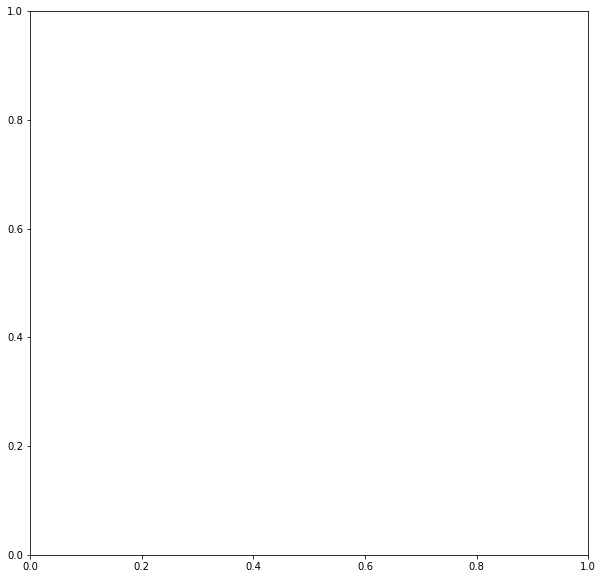

In [276]:
plt.subplots(figsize=(10, 10))
img = display_image_gamma(channel_to_img, channel_map)
plt.imshow(img)

In [13]:
def add_scale(img, mpm=1):
    x = img.shape[1] - 210
    y = img.shape[0] - 20
    
    x1, x2 = int(x), int(x + 200)
    y1, y2 = int(y), int(y + 5)
    
    for r in range(img.shape[0]):
        for c in range(img.shape[1]):
            if r > y1 and r <= y2 and c > x1 and c <= x2:
                img[r, c, 0] = 1.
                img[r, c, 1] = 1.
                img[r, c, 2] = 1.
    plt.text(x, y - 10, '200 um', fontsize=12, color='white')
    return img
    

In [16]:
channel_map = {
    'DAPI1': '#0008ff',
    'pancytok': '#ff0000',
    'CD3e': '#00ff04',
    'Ki67': '#fbff00',
    'CD31': '#00fff7',
    'CD20': '#ff00e1'
#     'CD68': '#ffffff'
}
# plt.subplots(figsize=(10, 10))
img = display_image_auto(channel_to_img, channel_map)
# img = display_image_raw(channel_to_img, channel_map)
# img = add_scale(img)
plt.imshow(img[:1000, :1000])

KeyboardInterrupt: 

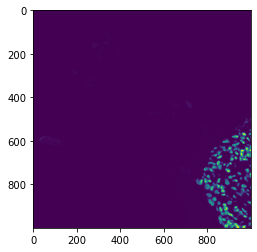

In [195]:
plt.imshow(channel_to_img['DAPI1'][:1000, :1000])

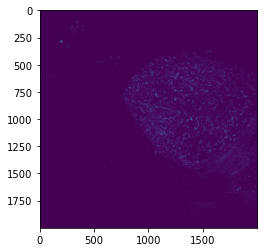

In [243]:
plt.imshow(channel_to_img['CD4'][:2000, :2000])

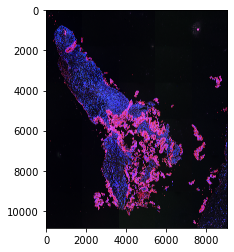

In [238]:
plt.imshow(img)

In [237]:
img.shape

(10848, 9040, 3)

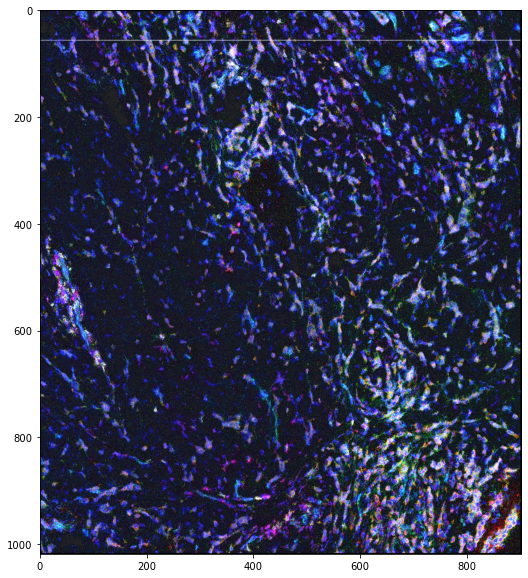

In [260]:
channel_map = {
    'HistoneH3': '#0008ff',
    'PanK': '#ff0000',
    'CD3': '#00ff04',
    'Ki67': '#fbff00',
    'CD31': '#00fff7',
    'CD20': '#ff00e1'
#     'CD68': '#ffffff'
}

channel_map = {
    'HistoneH3': '#0008ff',
    'PanK': '#ff0000',
    'Ecadherin': '#00ff04',
    'CD3': '#fbff00',
    'CD31': '#00fff7',
    'CD68': '#ff00e1'
#     'CD68': '#ffffff'
}

plt.subplots(figsize=(10, 10))
img = display_image_auto(channel_to_img, channel_map, )
plt.imshow(img)

In [73]:
from pathlib import Path

HT103B1_S1H4_A1_A4_100620_ROI001


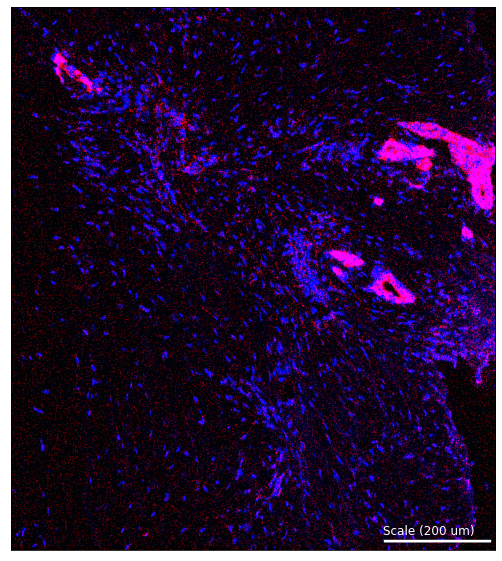

HT103B1_S1H4_A1_A4_100620_ROI002


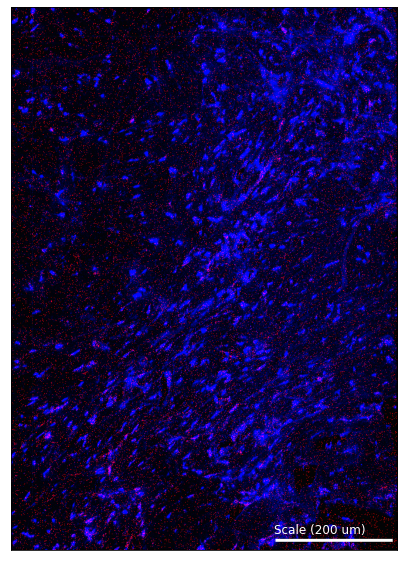

HT103B1_S1H7_A1_A4_100620_ROI001


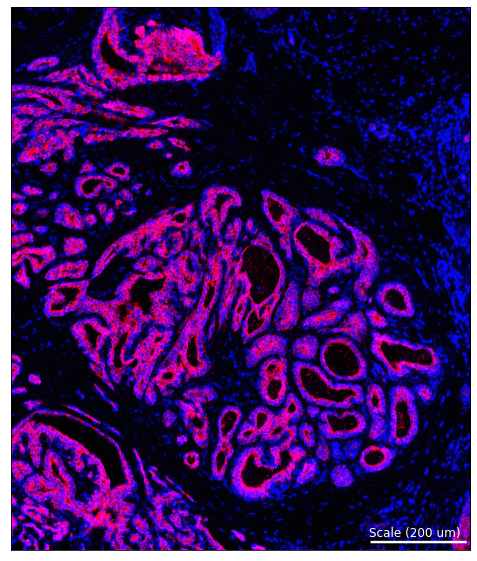

HT103B1_S1H7_A1_A4_100620_ROI002


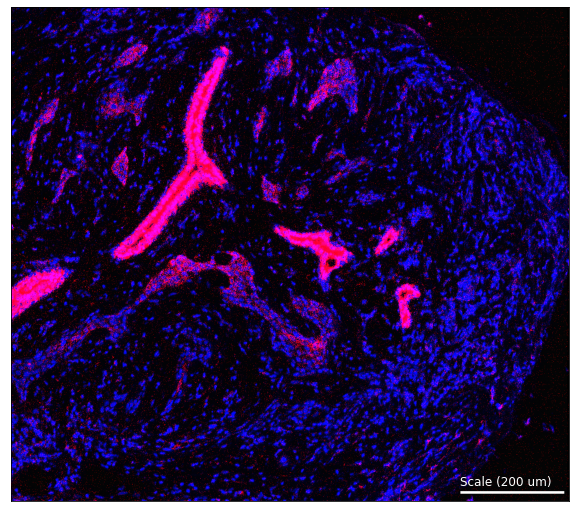

HT128B1_S1H3_A1_A4_100620_ROI001


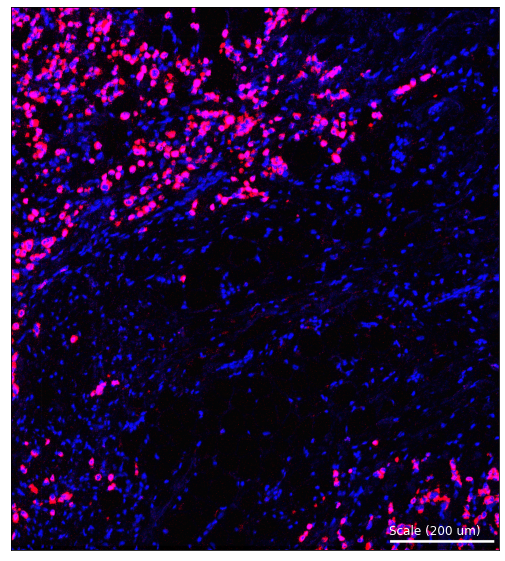

HT128B1_S1H3_A1_A4_100620_ROI002


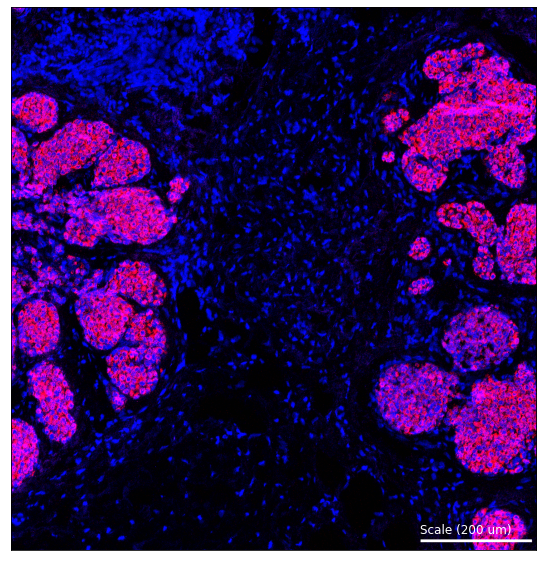

HT128B1_S1H4A4_100620_ROI001


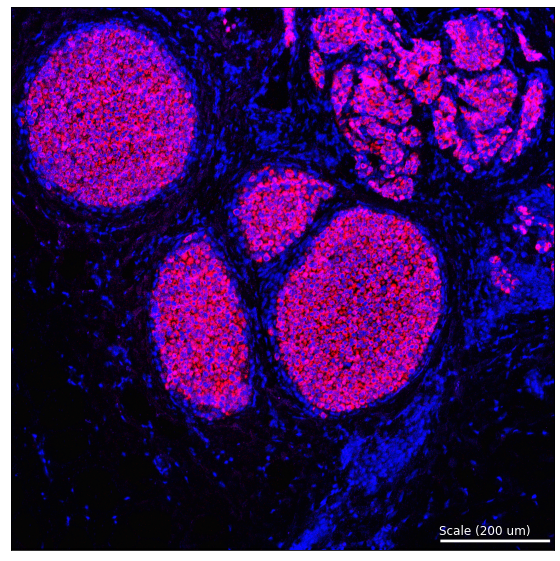

HT137B1_S1H7_A1_100620_ROI001


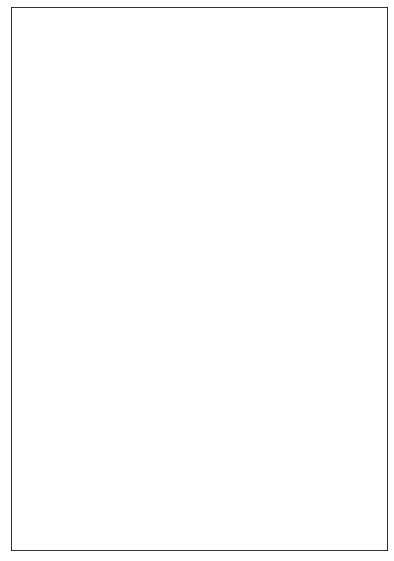

HT137B1_S1H7_A1_100620_ROI002


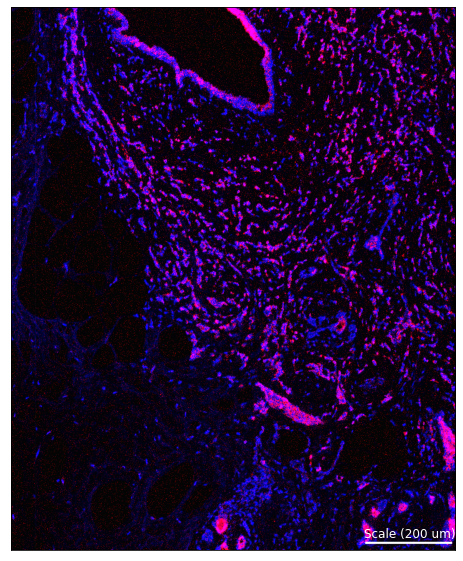

HT137B1_S1H7_A1_100620_ROI003


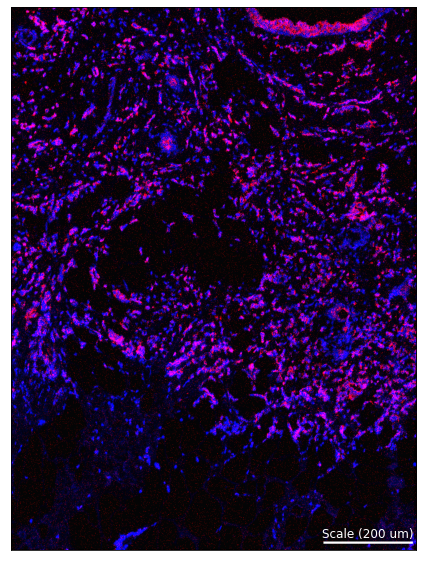

HT141B1_S1H1_100620_ROI001


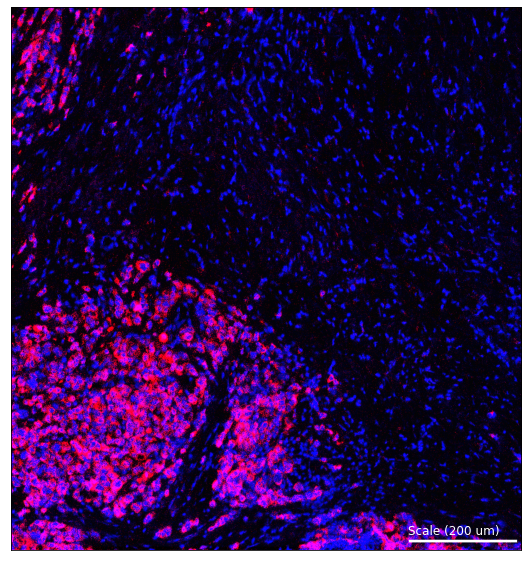

HT171B1_S1H1_100620_ROI001


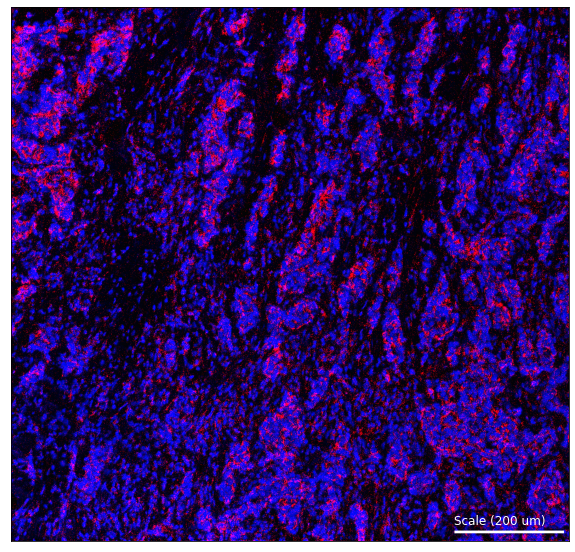

HT171B1_S1H1_100620_ROI002


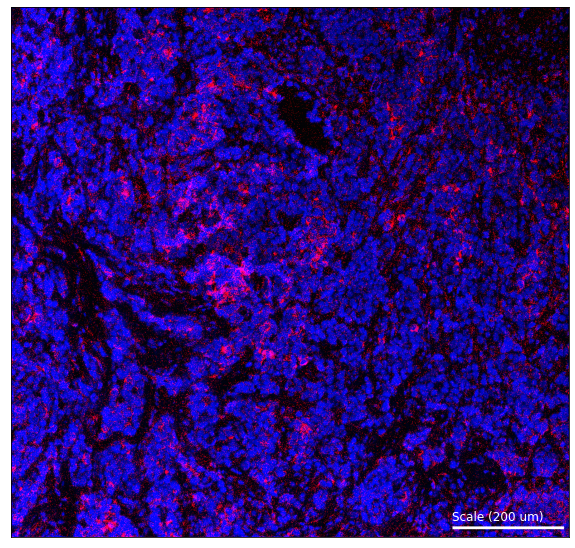

HT171B1_S1H8_100620_ROI001


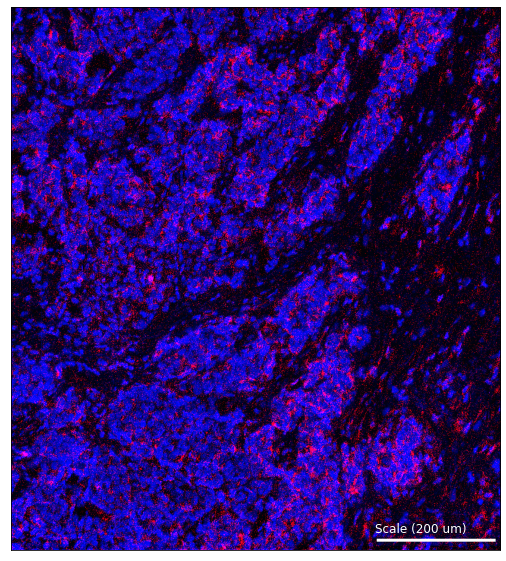

HT171B1_S1H8_100620_ROI002


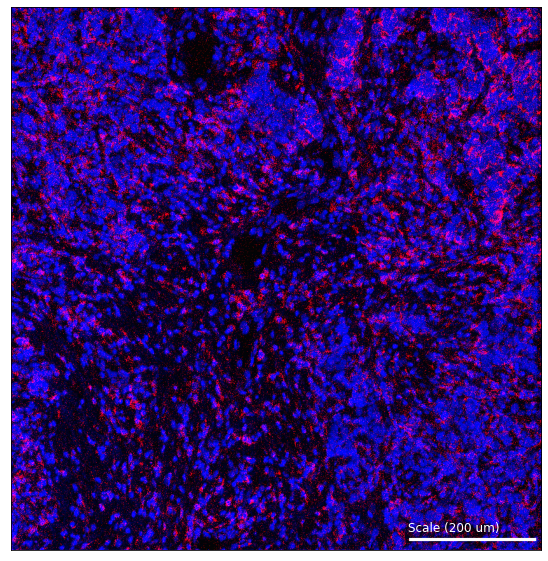

HT_029B_C_5_C_superior_100620_ROI001


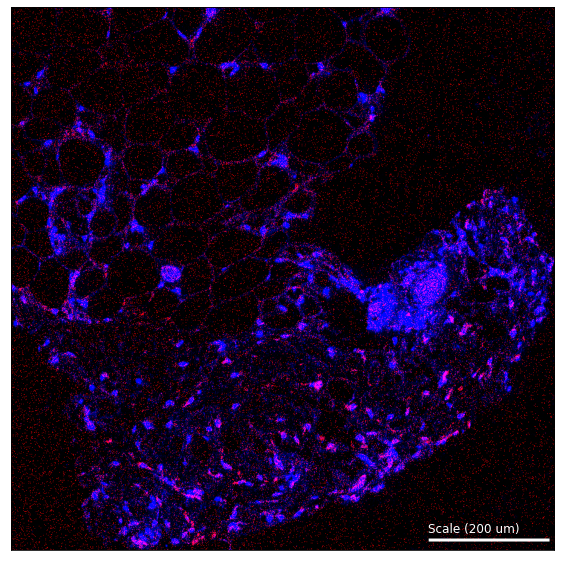

HT_036B_EI_E_inferior_100620_ROI001


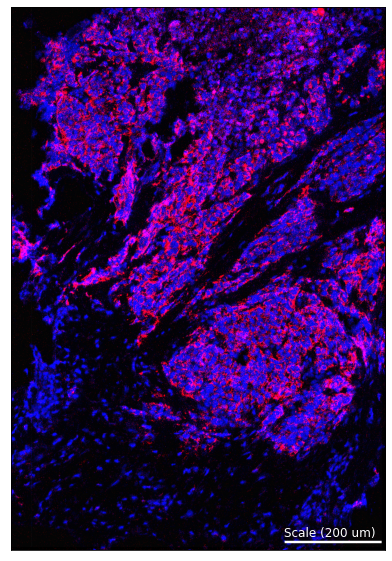

HT_036B_E_5_E_Superior_100620_ROI001


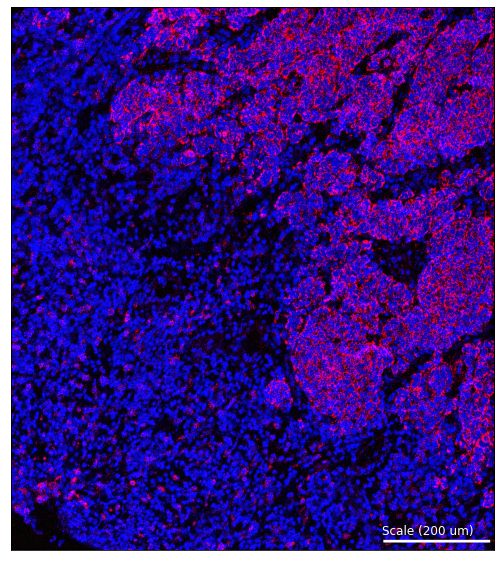

HT_077B1_S1H1_A1_A4_100620_ROI001


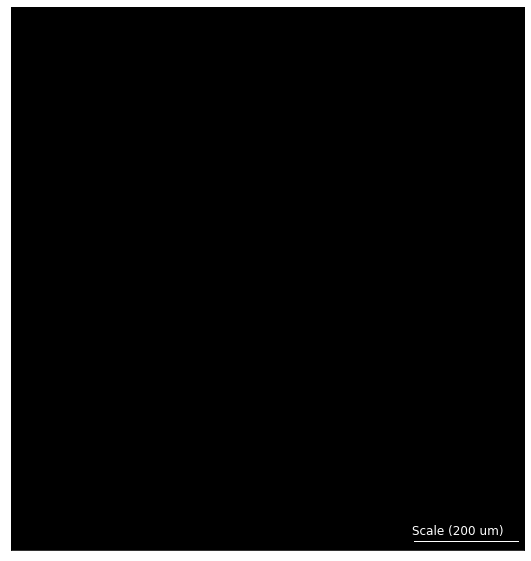

HT_077B1_S1H1_A1_A4_100620_ROI002


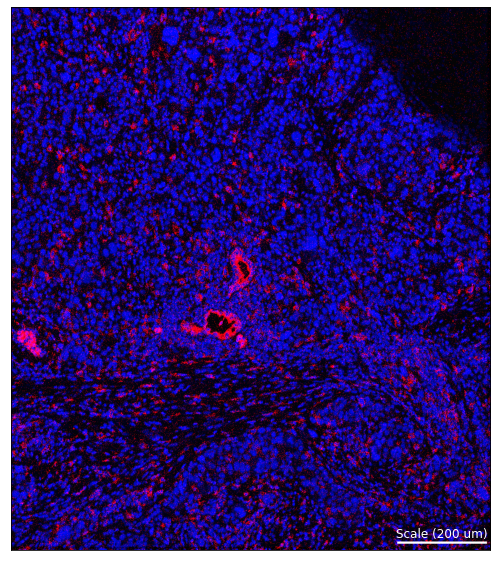

HT_077B1_S1H1_A1_A4_100620_ROI003


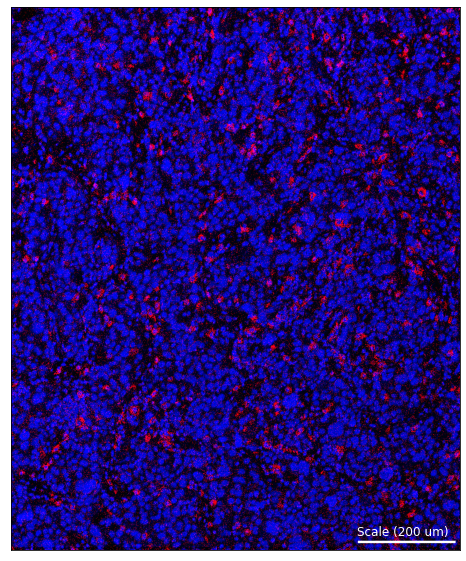

HT_077B1_S1H3_A1_A100620_ROI001


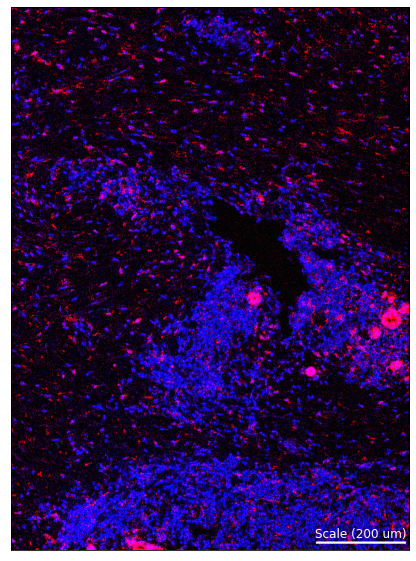

HT_077B1_S1H3_A1_A100620_ROI002


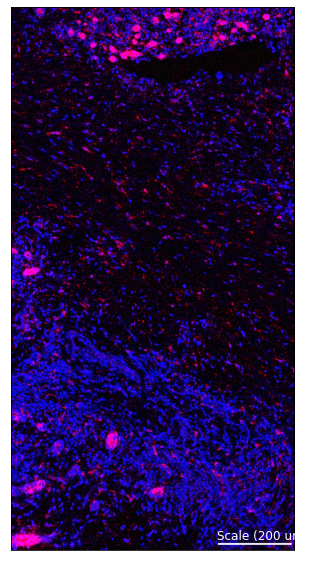

HT_077B1_S1H7_A1_A_100620_ROI001


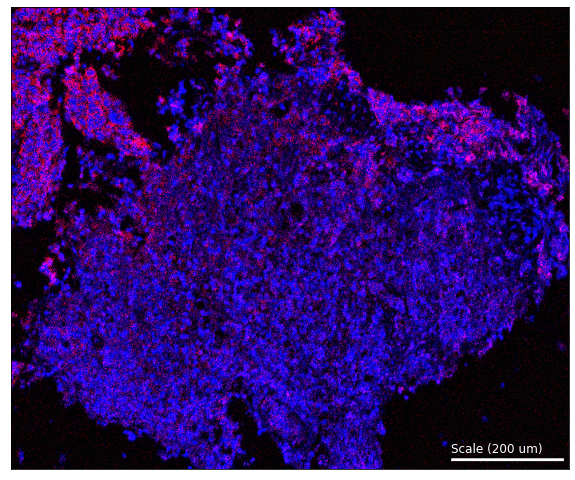

HT_077B1_S1H7_A1_A_100620_ROI002


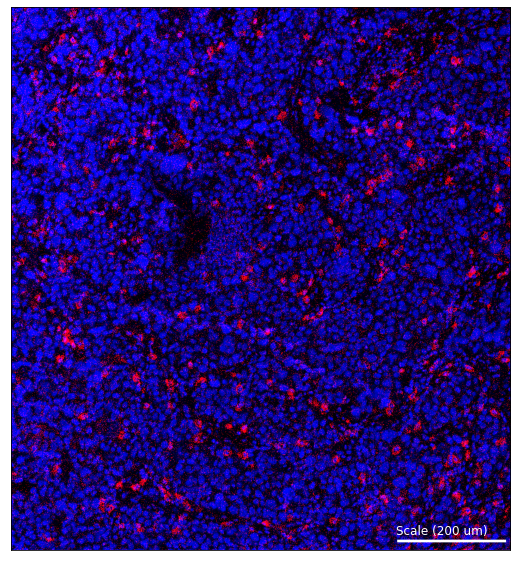

HT_088B1_S1H1_L1_L2_100620_ROI001


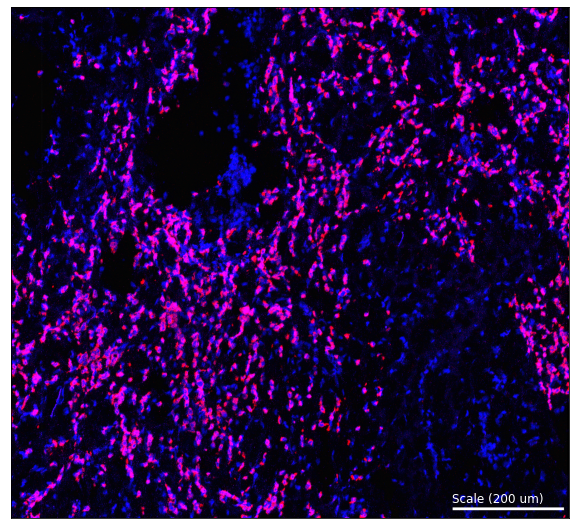

HT_088B1_S1H1_L1_L2_100620_ROI002


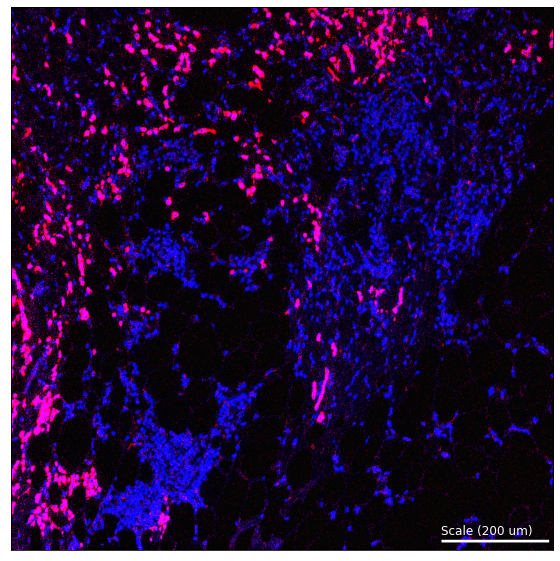

HT_088B1_S1H4_L1_100620_ROI001


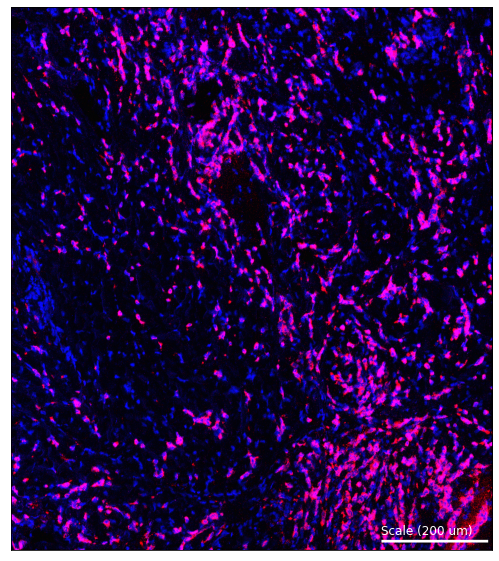

In [275]:
channel_map = {
    'HistoneH3': '#0008ff',
    'PanK': '#ff0000',
    'CD3': '#00ff04',
    'Ki67': '#fbff00',
    'CD31': '#00fff7',
    'CD20': '#ff00e1',
#     'CD68': '#ffffff'
}


channel_map = {
    'HistoneH3': '#0008ff',
    'PanK': '#ff0000',
    'CD3': '#00ff04',
    'Ki67': '#fbff00',
    'CD31': '#00fff7',
    'CD68': '#ff00e1',
    'FAP': '#ffffff'
}

channel_map = {
    'HistoneH3': '#0008ff',
    'PanK': '#ff0000',
#     'CD3': '#00ff04',
#     'Ki67': '#fbff00',
#     'CD31': '#00fff7',
#     'CD68': '#ff00e1',
#     'FAP': '#ffffff'
}

import os
fig_dir = '/home/estorrs/imaging/results/display/breast_pank_dapi'
Path(fig_dir).mkdir(parents=True, exist_ok=True)
for s, c_img in sample_to_imgs.items():
    print(s)
    plt.subplots(figsize=(10, 10))
    img = display_image_auto(c_img, channel_map, clip_limit=.01)
    img = add_scale(img)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img)
    plt.imsave(os.path.join(fig_dir, f'{s}.png'), img)
    plt.show()

In [495]:
next(iter(sample_to_imgs.values())).keys()

dict_keys(['SMA', 'vimentin', 'PanCK', 'PDL1', 'FOXP3', 'CD4', 'Ecadherin', 'CD68', 'CD20', 'CD8a', 'PD1', 'GranzymeB', 'Ki67', 'CollagenT1', 'CD3', 'CD45RO', 'HistoneH3', 'DNA1', 'DNA2', 'cellseg1', 'cellseg2', 'cellseg3', 'nuclear', 'membrane'])

In [41]:
def colorize_bw(img, rgb):
    grayscale_image = img / max(img.flatten())
    image = color.gray2rgb(grayscale_image)
    
    colored = rgb * image
    return colored

def display_image_gamma(channel_to_img, channels, gamma=.03):
    if isinstance(channels, dict):
        channel_to_color = {ch:(hex_to_rgb(c), g) for ch, (c, g) in channels.items()}
    else:
        channel_to_color = {c:(hex_to_rgb(DEFAULTS[i]), .5) for i, c in enumerate(channels)}
    
    final = None
    for c, (color, g) in channel_to_color.items():
        img = channel_to_img[c].copy()
        colorized = colorize_bw(img, list(color))
#         p1, p2 = np.percentile(colorized, (5, 100))
#         colorized = exposure.rescale_intensity(colorized, in_range=(p1, p2))
#         img = exposure.adjust_gamma(colorized, gamma=g)
        img = colorized
#         p1, p2 = np.percentile(img, (0, 100))
#         img = exposure.rescale_intensity(img, in_range=(p1, p2))
        
        if final is None:
            final = img
        else:
            final += img
    p1, p2 = np.percentile(final, (0, 100))
    final = exposure.rescale_intensity(final, in_range=(p1, p2))
#     final = exposure.adjust_gamma(final, gamma=.5)
    final = exposure.equalize_adapthist(final, clip_limit=.03)
    return final

def display_image_raw(channel_to_img, channels):
    if isinstance(channels, dict):
        channel_to_color = {ch:(hex_to_rgb(c), g) for ch, (c, g) in channels.items()}
    else:
        channel_to_color = {c:(hex_to_rgb(DEFAULTS[i]), .5) for i, c in enumerate(channels)}
    
    final = None
    for c, (color, g) in channel_to_color.items():
        img = channel_to_img[c].copy()
        colorized = colorize_bw(img, list(color))
        img = colorized
        if final is None:
            final = img
        else:
            final += img
    p1, p2 = np.percentile(final, (0, 100))
    final = exposure.rescale_intensity(final, in_range=(p1, p2))
    return final

S18_40270_C3_JH010721_roi2


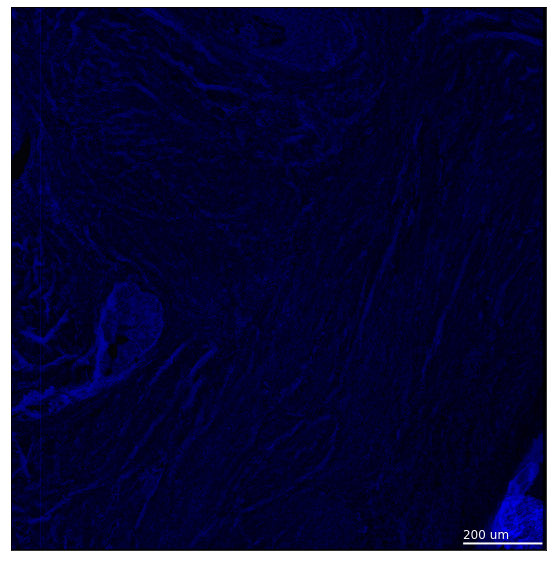

In [535]:


# channel_map = {
#     'HistoneH3': ('#0000ff', .4),
#     'PanK': ('#ff0000', .1),
#     'CD3': ('#00ff00', .55),
#     'Ki67': ('#ffff00', .5),
#     'FAP': ('#00ffff', .3),
# #     'FAP': ('#ffffff', .6),
    
# #     'CD31': ('#00fff7', .4),
# #     'CD20': ('#ff00e1', .3),
# #     'CD68': '#ffffff'
# }
channel_map = {
    'CD8a': ('#0000ff', .9),
    'Ecadherin': ('#ff0000', .9),
    'CD68': ('#00ff00', .9),
    'CD20': ('#ff00ff', .9),
    'CD4': ('#00ffff', .9),
    'Ki67': ('#ffffff', .9),
}

channel_map = {
    'CollagenT1': ('#0000ff', .9),
    'SMA': ('#ff0000', .9),
    'CD8a': ('#00ff00', .9),
    'vimentin': ('#ffff00', .9),
}

channel_map = {
    'cellseg1': ('#0000ff', .9),
#     'SMA': ('#ff0000', .9),
#     'CD8a': ('#00ff00', .9),
#     'vimentin': ('#ffff00', .9),
}

# channel_map = {
# #     'HistoneH3': ('#0000ff', .9),
#     'PanK': ('#ff0000', .9),
#     'CD8a': ('#00ff00', .9),
#     'CD4': ('#ffffff', .9),
#     'Lag3': ('#0000ff', .9),
# #     'FAP': ('#ffffff', .6),
    
# #     'CD31': ('#00fff7', .4),
# #     'CD20': ('#ff00e1', .3),
# #     'CD68': '#ffffff'
# }

# channel_map = {
#     'HistoneH3': ('#0008ff', .4),
#     'PanK': ('#ff0000', .35),
#     'FOXP3': ('#ffff00', .35),
#     'CD4': ('#00ff00', .55),
#     'CD8a': ('#ffffff', .45),
# #     'FAP': ('#ffffff', .6),
    
# #     'CD31': ('#00fff7', .4),
# #     'CD20': ('#ff00e1', .3),
# #     'CD68': '#ffffff'
# }


interesting = sample_to_imgs.keys()
# interesting = ['HT_036B_E_5_E_Superior_100620_ROI001',
#               'HT_088B1_S1H4_L1_100620_ROI001',
#               'HT137B1_S1H7_A1_100620_ROI002',
#               ]

# interesting = ['HT_077B1_S1H1_A1_A4_100620_ROI002',
#               'HT_077B1_S1H1_A1_A4_100620_ROI003',
#               'HT_077B1_S1H7_A1_A_100620_ROI001',
#                'HT_077B1_S1H7_A1_A_100620_ROI002',
#                'HT171B1_S1H1_100620_ROI001',
#                'HT171B1_S1H1_100620_ROI002',
#                'HT171B1_S1H8_100620_ROI001',
#                'HT171B1_S1H8_100620_ROI002'
#               ]

import os
fig_dir = '/home/estorrs/imaging/results/display/sandbox'
Path(fig_dir).mkdir(parents=True, exist_ok=True)
for s, c_img in sample_to_imgs.items():
    if s in interesting:
        print(s)
        plt.subplots(figsize=(10, 10))
        img = display_image_gamma(c_img, channel_map)
        img = add_scale(img)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(img)
        plt.imsave(os.path.join(fig_dir, f'{s}.png'), img)
        plt.show()

In [40]:
channel_to_img.keys()

dict_keys(['dapi1', 'Ki67', 'CD31', 'CD4', 'dapi11', 'CD3', 'CD8', 'CD90', 'nuclear', 'membrane'])

In [43]:
import os
channel_map = {
    'DAPI1': ('#0000ff', .9),
    'ecadherin': ('#ff0000', .9),
    'CD8': ('#00ff00', .9),
    'CD20': ('#ff00ff', .9),
#     'CD31': ('#00ffff', .9),
    'Ki67': ('#ffff00', .9),
}

channel_map = {
    'dapi1': ('#0000ff', .9),
    'CD4': ('#ff0000', .9),
    'CD8': ('#00ff00', .9),
    'CD90': ('#ff00ff', .9),
#     'CD31': ('#00ffff', .9),
    'Ki67': ('#ffff00', .9),
}

print('start')
img = display_image_gamma(channel_to_img, channel_map)
print('done creating')
from pathlib import Path
fig_dir = '/home/estorrs/imaging/results/display/spleen_codex_test'
Path(fig_dir).mkdir(parents=True, exist_ok=True)
print('saving')
plt.imsave(os.path.join(fig_dir, f'test_spleen.png'), img)

start
done creating
saving


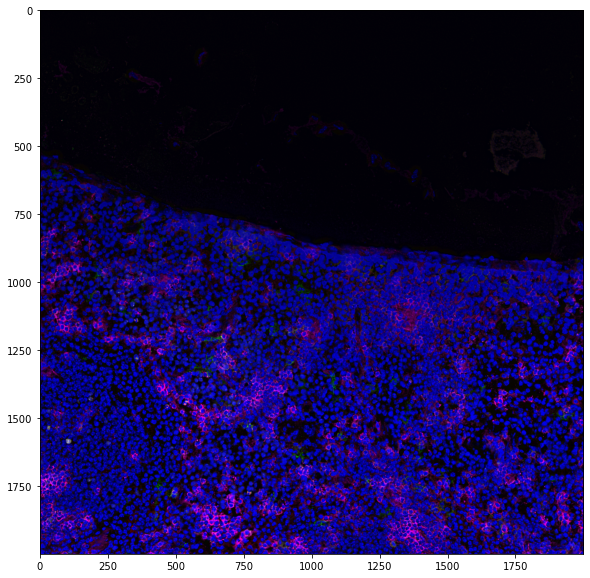

In [44]:
plt.subplots(figsize=(10, 10))
plt.imshow(img[:2000, :2000])

In [25]:
img.shape

(9040, 10848, 3)

In [45]:
def display_legend(channel_map):
    fig, axs = plt.subplots(ncols=len(channel_map), figsize=(5, 1))
    for i, (c, color) in enumerate(channel_map.items()):
        ax = axs[i]
        ax.axhline(0, color=color, linewidth=110)
        ax.set_ylabel(c)
        ax.set_xticks([])
        ax.set_yticks([])
    return axs

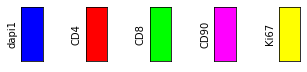

In [46]:
# display_legend(channel_map)
import os
display_legend({k:m for k, (m, g) in channel_map.items()})
# plt.tight_layout(pad=50.0)
plt.subplots_adjust(wspace=2.)
plt.savefig(os.path.join(fig_dir, 'legend.png'))

In [ ]:
['SMA', 'podoplanin', 'Vimentin', 'CD74', 'Type1Coll', 'FAP', 'HistoneH3']

In [162]:
channel_map = {
    'HistoneH3': '#0008ff',
    'SMA': '#ff0000',
    'podoplanin': '#00ff04',
    'CD74': '#fbff00',
    'Vimentin': '#00fff7',
    'FAP': '#ff00e1',
    'Type1Coll': '#ffffff'
}
import os
fig_dir = '/home/estorrs/imaging/results/display/breast_caf'
Path(fig_dir).mkdir(parents=True, exist_ok=True)
for s, c_img in sample_to_imgs.items():
    print(s)
    plt.subplots(figsize=(10, 10))
    img = display_image_auto(c_img, channel_map, clip_limit=.02)
    img = add_scale(img)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img)
    plt.imsave(os.path.join(fig_dir, f'{s}.png'), img)
    plt.show()

In [164]:
fig_dir

'/home/estorrs/imaging/results/display/breast_caf'

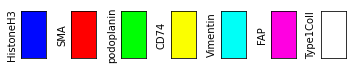

In [163]:
display_legend(channel_map)
plt.tight_layout()
plt.savefig(os.path.join(fig_dir, 'legend.png'))

#### do nuclear and membrane segmentation

In [ ]:
# from deepcell.applications import ScaleDetection

In [ ]:
# m = ScaleDetection()

In [524]:
app = MultiplexSegmentation()
def get_coordinates(img):
    ids = sorted(set(img.flatten()))
    d = {}
    for c_id in ids:
        idxs = np.argwhere(img==c_id)
        r1, r2 = min(idxs[:, 0].flatten()), max(idxs[:, 0].flatten())
        c1, c2 = min(idxs[:, 1].flatten()), max(idxs[:, 1].flatten())
        d[c_id] = (r1 + ((r2 - r1) * .5), c1 + ((c2 - c1) * .5))
    return d

def run_whole_cell_segmentation(nuclear_img, membrane_img, w=140, p=30):
    """Return 64 bit int segmentation mask for given nuclear and membrane images"""
    im = np.stack((nuclear_img, membrane_img), axis=-1)
    w = 140
    p = 30

    nrows = int(im.shape[0] / w) + 1
    ncols = int(im.shape[1] / w) + 1

    img = np.zeros(((w * nrows) + (p*2), (w * ncols) + (p*2), im.shape[2]))
    img[p:im.shape[0] + p, p:im.shape[1] + p, :] = im
    imgs = None
    for r in range(nrows):
        for c in range(ncols):
            r1, r2 = (r * w), ((r+1) * w) + (p*2)
            c1, c2 = (c * w), ((c+1) * w) + (p*2)

            small = img[r1:r2, c1:c2]
            small = np.expand_dims(small, 0)

            if imgs is None:
                imgs = small
            else:
                imgs = np.concatenate((imgs, small), axis=0)

    labeled_img = app.predict(imgs)
    
    
    final = np.zeros(((w * nrows) + (p*2), (w * ncols) + (p*2))).astype(np.int64)
    count = 0
    for r in range(nrows):
        for c in range(ncols):
            r1, r2 = (r * w), ((r+1) * w) + (p*2)
            c1, c2 = (c * w), ((c+1) * w) + (p*2)
            small = labeled_img[count, :, :, 0].copy()

            wr1, wr2 = r1 + p, r2 - p
            wc1, wc2 = c1 + p, c2 - p
            cell_to_center = get_coordinates(small)
            # remove cells whose center point fall outside of the window
            for c_id in sorted(set(small.flatten())):
                x, y = cell_to_center[c_id]
    #             print(x, y)
                if y < p: small[small==c_id] = 0
                if y > small.shape[0] - p: small[small==c_id] = 0
                if x < p: small[small==c_id] = 0
                if x > small.shape[1] - p: small[small==c_id] = 0

            current = len(set(final.flatten()))
            labels = sorted(set(small.flatten()))
            for label in labels:
                if label != 0: small[small==label] = label + current
            i2 = np.zeros(final.shape)
            i2[r1:r2, c1:c2] = small
            final = final + i2
            count+=1

    final = final[p:im.shape[0] + p, p:im.shape[1] + p]

    # reassign labels so they actually are in order
    to_new_label = {c:i for i, c in enumerate(sorted(set(final.flatten())))}
    for old, new in to_new_label.items():
        final[final==old] = int(new)
    final = final.astype(np.int64)

    return final
            


In [525]:
next(iter(sample_to_imgs.values())).keys()

dict_keys(['SMA', 'vimentin', 'PanCK', 'PDL1', 'FOXP3', 'CD4', 'Ecadherin', 'CD68', 'CD20', 'CD8a', 'PD1', 'GranzymeB', 'Ki67', 'CollagenT1', 'CD3', 'CD45RO', 'HistoneH3', 'DNA1', 'DNA2', 'cellseg1', 'cellseg2', 'cellseg3', 'nuclear', 'membrane', 'segmentation_mask'])

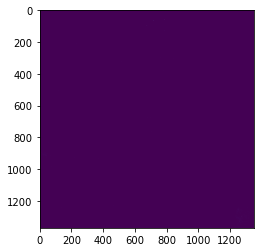

In [528]:
plt.imshow(next(iter(sample_to_imgs.values()))['nuclear'].astype(np.int32))

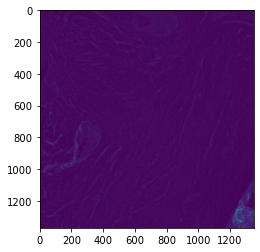

In [529]:
plt.imshow(next(iter(sample_to_imgs.values()))['membrane'])

In [518]:
for sample, d in sample_to_imgs.items():
    print(sample)
    mask = run_whole_cell_segmentation(d['nuclear'], d['membrane'])
    d['segmentation_mask'] = mask

S18_40270_C3_JH010721_roi1
S18_40270_C3_JH010721_roi2


/home/estorrs/miniconda3/envs/imaging/lib/python3.7/site-packages/deepcell_toolbox/deep_watershed.py:189: UserWarning: Only one label was provided to `remove_small_objects`. Did you mean to use a boolean array?
  label_image = remove_small_objects(label_image, min_size=small_objects_threshold)


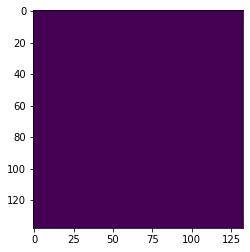

In [519]:
plt.imshow(next(iter(sample_to_imgs.values()))['segmentation_mask'])

In [520]:
ls = [np.count_nonzero((next(iter(sample_to_imgs.values()))['segmentation_mask']==i).flatten())
      for i in set(next(iter(sample_to_imgs.values()))['segmentation_mask'].flatten()) if i!=0]
ls

[]

In [521]:
sample_to_imgs.pop('S18_40270_C3_JH010721_roi1')

{'SMA': array([[0.       , 0.       , 0.       , ..., 0.       , 2.0179222,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 2.0489671, 1.1486634, ..., 0.       , 0.       ,
         0.       ],
        ...,
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 2.       ,
         0.       ],
        [0.       , 1.       , 0.       , ..., 0.       , 0.       ,
         0.       ]], dtype=float32),
 'vimentin': array([[1.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         1.2168908],
        [0.       , 0.       , 0.       , ..., 3.87214  , 4.27777  ,
         8.461933 ],
        ...,
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         1.       ],
        [0.       , 0.       , 0.     

In [ ]:
import seaborn as sns
sns.distplot(ls)
# plt.xlim((0, 5000))

In [ ]:
# plt.imshow(final[220:250, 220:230])

#### get intensities and normalize

In [522]:
adata = None
for sample, d in sample_to_imgs.items():
    print(sample)
    segmentation_mask = d['segmentation_mask']
    # we exclude 0 bc thats not a cell
    cells = sorted(set(segmentation_mask.flatten()))[1:]
    data, channels = [], [c for c in d.keys() if c not in ['segmentation_mask', 'nuclear', 'membrane']]
    areas = []
    for cell in cells:
        mask = segmentation_mask==cell
        area = np.count_nonzero(mask)
        areas.append(area)
        ls = []
        for channel in channels:
            ls.append(np.sum(d[channel][mask]) / area)
        data.append(ls)
    
    df = pd.DataFrame(data=data, columns=channels, index=[f'{sample}_{i}' for i in range(len(cells))])
    
    small = anndata.AnnData(X=df.values)
    small.obs.index = df.index.to_list()
    small.var.index = df.columns
    small.obs['area'] = areas
    small.obs['sample'] = sample
    
    if adata is None:
        adata = small
    else:
        adata = anndata.concat((adata, small))
adata

S18_40270_C3_JH010721_roi2


AnnData object with n_obs × n_vars = 6 × 22
    obs: 'area', 'sample'

In [523]:
adata

AnnData object with n_obs × n_vars = 6 × 22
    obs: 'area', 'sample'

In [ ]:
adata.obs

In [ ]:
sns.distplot([x for x in adata.obs['area'] if x <= 1000])

In [ ]:
filtered = adata[adata.obs['area']<=600]
filtered = filtered[filtered.obs['area']>=10]

In [ ]:
sns.distplot(filtered.obs['area'])

In [ ]:
# sns.distplot(filtered.obs['area'])

In [ ]:
# plt.imshow(next(iter(sample_to_imgs.values()))['segmentation_mask'][100:200, 100:200])

In [ ]:
# 3.14 * pow(2, 2)

#### UMAP/leiden based cell typing

In [ ]:
sc.pp.scale(filtered)
sc.pp.pca(filtered)
sc.pp.neighbors(filtered)
sc.tl.umap(filtered)

In [ ]:
# !pip install leidenalg

In [ ]:
clustering = filtered.copy()
exclude = {'PD1', 'PD-L1', 'Lag3', 'CD45RO', 'HLA-DR', 'HistoneH3', 'DNA', 'cellseg1', 'cellseg2', 'cellseg3',
          'CKG', 'GranzymeB', 'CD11c', 'CD133'}
clustering = clustering[:, [v for v in clustering.var.index if v not in exclude]]
sc.pp.pca(clustering)
sc.pp.neighbors(clustering, n_neighbors=15)
sc.tl.umap(clustering)
sc.tl.leiden(clustering, resolution=1.)

In [ ]:
sc.pl.umap(clustering, color=[c for c in clustering.var.index], ncols=3)

In [ ]:
sc.pl.umap(clustering, color=['sample', 'leiden'], ncols=1, legend_loc='on data')

In [ ]:
cell_to_cluster = {
    'Malignant': ['13', '7', '15', '19', '21'],
    'Endothelial/CAF': ['4', '12', '11', '20', '6'],
    'Monocyte': ['1'],
    'CD4': ['16'],
    'CD8': ['9'],
    'Treg': ['18'],
    'Dendritic': ['14'],
    'B': ['8'],
    'Proliferating': ['2', '3']
}
cluster_to_cell = {v:k for k, vs in cell_to_cluster.items() for v in vs}
clustering.obs['cell_type'] = [cluster_to_cell.get(x, 'Other') for x in clustering.obs['leiden']]


In [ ]:
sc.pl.umap(clustering, color=['leiden', 'cell_type'])

In [ ]:
small = clustering.copy()
small = small[small.obs['cell_type']=='Endothelial/CAF']
sc.pp.pca(small)
sc.pp.neighbors(small, n_neighbors=15)
sc.tl.umap(small)
sc.tl.leiden(small, resolution=.5)

In [ ]:
sc.pl.umap(small, color=['leiden', 'SMA', 'Vimentin', 'FAP', 'CD74', 'Type1Coll', 'CD31'])

In [ ]:
d = {
    'myCAF': ['7'],
    'Endothelial': ['8', '0', '6'],
    'CAF1': ['1'],
    'CAF2': ['2']
}
r = {v:k for k, vs in d.items() for v in vs}
small.obs['cell_type'] = [r.get(x, 'Other') for x in small.obs['leiden']]


In [ ]:
sc.pl.umap(small, color=['cell_type'])

In [ ]:
clustering.obs['cell_type'] = [small.obs.loc[i, 'cell_type'] if c=='Endothelial/CAF' else c
                                             for i, c in zip(clustering.obs.index, clustering.obs['cell_type'])]
sc.pl.umap(clustering, color=['cell_type'])

#### downstream

cell porportions

In [ ]:
clustering.obs

In [ ]:
clustering.obs['image_id'] = clustering.obs['sample'].to_list()
clustering.obs['sample_id'] = ['_'.join(x.split('_')[:2]) for x in clustering.obs['image_id']]
clustering.obs

In [ ]:
from collections import Counter
def plot_proportion(adata, percentage=True):
    samples = sorted(set(adata.obs['sample_id']))
    cell_types = sorted(set(adata.obs['cell_type']))

    data = []
    for s in samples:
        mini = adata.obs[adata.obs['sample_id']==s]
        counts = Counter(mini['cell_type'])
        for c in cell_types:
            data.append([s, c, counts.get(c, 0)/mini.shape[0] if percentage else counts.get(c, 0)])
    df = pd.DataFrame(data=data)
    df.columns = ['sample', 'cell_type', 'fraction' if percentage else 'count']

    return alt.Chart(df).mark_bar().encode(
        x='sample',
        y='fraction' if percentage else 'count',
        color='cell_type'
    )
    
plot_proportion(clustering, percentage=False)

In [ ]:
plot_proportion(clustering, percentage=True)

In [ ]:
caf_mask = [True if 'CAF' in c else False for c in clustering.obs['cell_type']]
plot_proportion(clustering[caf_mask], percentage=False)

In [ ]:
plot_proportion(clustering[caf_mask], percentage=True)

display image

In [ ]:
img = sample_to_imgs[]

In [ ]:
d = next(iter(sample_to_imgs.values()))
d.keys()

In [ ]:
plt.imshow(grayscale_image)

In [ ]:
max(d['HLA-DR'].flatten())

In [ ]:
from skimage import color
# c = .1
# grayscale_image = d['HLA-DR'] / (max(d['HLA-DR'].flatten()) * c)
grayscale_image = d['HLA-DR'] / max(d['HLA-DR'].flatten())
# p1, p2 = np.percentile(grayscale_image, (2, 98))
# grayscale_image = exposure.rescale_intensity(grayscale_image, in_range=(p1, p2), )
# grayscale_image = exposure.equalize_adapthist(grayscale_image, clip_limit=0.03)
# grayscale_image[grayscale_image>1] = 1.
image = color.gray2rgb(grayscale_image)

red_multiplier = [1, 0, 0]
yellow_multiplier = [1, 1, 0]

fig, (ax1, ax2, ax3) = plt.subplots(nrows=3, figsize=(16, 16*3),
                               sharex=True, sharey=True)
r = (red_multiplier * image) / max((red_multiplier * image).flatten())
ax1.imshow(r)
ax2.imshow(yellow_multiplier * image)
ax3.imshow((yellow_multiplier * image) + (red_multiplier * image))


In [ ]:
from skimage import exposure

In [ ]:
print(max(r.flatten()))

In [ ]:
# Contrast stretching
img = r.copy()
p2, p98 = np.percentile(img, (2, 98))
img_rescale = exposure.rescale_intensity(img, in_range=(p2, p98), )

# Equalization
img_eq = exposure.equalize_hist(img)

# Adaptive Equalization
print(max(img.flatten()))
img_adapteq = exposure.equalize_adapthist(img, clip_limit=0.03)

# Display results
fig = plt.figure(figsize=(8, 5))
axes = np.zeros((2, 4), dtype=np.object)
axes[0, 0] = fig.add_subplot(2, 4, 1)
for i in range(1, 4):
    axes[0, i] = fig.add_subplot(2, 4, 1+i, sharex=axes[0,0], sharey=axes[0,0])
for i in range(0, 4):
    axes[1, i] = fig.add_subplot(2, 4, 5+i)


In [ ]:
plt.subplots(figsize=(10, 10))
plt.imshow(img)

In [ ]:
plt.subplots(figsize=(10, 10))
plt.imshow(exposure.equalize_adapthist(r, clip_limit=0.03))

In [ ]:
plt.subplots(figsize=(10, 10))
plt.imshow(exposure.equalize_adapthist(img, clip_limit=0.01))